In [1]:
!pip install -U diffusers transformers

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
!apt-get update
!apt-get install p7zip-full -y

Hit:1 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:2 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Get:3 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Get:4 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,632 B]
Hit:5 https://cli.github.com/packages stable InRelease
Get:6 http://archive.ubuntu.com/ubuntu jammy-backports InRelease [127 kB]
Get:7 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease [1,581 B]
Hit:8 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Hit:9 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Hit:10 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy InRelease
Get:11 http://security.ubuntu.com/ubuntu jammy-security/universe amd64 Packages [1,289 kB]
Get:12 http://security.ubuntu.com/ubuntu jammy-security/main amd64 Packages [3,526 kB]
Get:13 http://security.ubuntu.com/ubuntu jammy-security/restricted a

In [4]:
!7z x "/content/drive/MyDrive/Dataset.7z"


7-Zip [64] 16.02 : Copyright (c) 1999-2016 Igor Pavlov : 2016-05-21
p7zip Version 16.02 (locale=en_US.UTF-8,Utf16=on,HugeFiles=on,64 bits,2 CPUs Intel(R) Xeon(R) CPU @ 2.00GHz (50653),ASM,AES-NI)

Scanning the drive for archives:
  0M Scan /content/drive/MyDrive/                                 1 file, 1170727703 bytes (1117 MiB)

Extracting archive: /content/drive/MyDrive/Dataset.7z
--
Path = /content/drive/MyDrive/Dataset.7z
Type = 7z
Physical Size = 1170727703
Headers Size = 17284
Method = LZMA:23
Solid = +
Blocks = 1

  0%      0% - Dataset/images/TCGA-2H-A9GF-01A . B101-4F35-90F7-9D1B37BED787.jpg                                                                          0% 1 - Dataset/images/TCGA-2H-A9GH-01A . 6CC9-4CD3-AEEC-4612C1726D0E.jpg

In [5]:
from huggingface_hub import login
login()

In [6]:
import torch

from diffusers import DiffusionPipeline
from diffusers import AutoencoderKL

device = torch.device('cuda')

# We do not host the weights of the SD3 VAE -- load it from StabilityAI
sd3_vae = AutoencoderKL.from_pretrained("stabilityai/stable-diffusion-3.5-large", subfolder="vae")

pipeline = DiffusionPipeline.from_pretrained(
    "StonyBrook-CVLab/PixCell-256",
    vae=sd3_vae,
    custom_pipeline="StonyBrook-CVLab/PixCell-pipeline",
    trust_remote_code=True,
    torch_dtype=torch.float16,
)

pipeline.to(device)

config.json:   0%|          | 0.00/809 [00:00<?, ?B/s]

vae/diffusion_pytorch_model.safetensors:   0%|          | 0.00/168M [00:00<?, ?B/s]

model_index.json:   0%|          | 0.00/285 [00:00<?, ?B/s]

pipeline.py: 0.00B [00:00, ?B/s]

pixcell_transformer_2d.py: 0.00B [00:00, ?B/s]

Fetching 5 files:   0%|          | 0/5 [00:00<?, ?it/s]

transformer/diffusion_pytorch_model.safe(…):   0%|          | 0.00/2.43G [00:00<?, ?B/s]

pixcell_transformer_2d.py: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/862 [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/828 [00:00<?, ?B/s]

Keyword arguments {'trust_remote_code': True} are not expected by PixCellPipeline and will be ignored.


Loading pipeline components...:   0%|          | 0/3 [00:00<?, ?it/s]

The config attributes {'double_self_attention': False, 'num_vector_embeds': None, 'only_cross_attention': False, 'use_linear_projection': False} were passed to PixCellTransformer2DModel, but are not expected and will be ignored. Please verify your config.json configuration file.
Expected types for transformer: (<class 'diffusers_modules.local.StonyBrook-CVLab--PixCell-pipeline.2730c93b7b1c71aa99f09c6dc4623d80caaa9bec.pixcell_transformer_2d.PixCellTransformer2DModel'>,), got <class 'diffusers_modules.local.pixcell_transformer_2d.PixCellTransformer2DModel'>.


PixCellPipeline {
  "_class_name": "PixCellPipeline",
  "_diffusers_version": "0.35.2",
  "_name_or_path": "StonyBrook-CVLab/PixCell-256",
  "scheduler": [
    "diffusers",
    "DPMSolverMultistepScheduler"
  ],
  "transformer": [
    "diffusers_modules.local.pixcell_transformer_2d",
    "PixCellTransformer2DModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

In [8]:
import timm
from timm.data import resolve_data_config
from timm.data.transforms_factory import create_transform

timm_kwargs = {
            'img_size': 224,
            'patch_size': 14,
            'depth': 24,
            'num_heads': 24,
            'init_values': 1e-5,
            'embed_dim': 1536,
            'mlp_ratio': 2.66667*2,
            'num_classes': 0,
            'no_embed_class': True,
            'mlp_layer': timm.layers.SwiGLUPacked,
            'act_layer': torch.nn.SiLU,
            'reg_tokens': 8,
            'dynamic_img_size': True
        }
uni_model = timm.create_model("hf-hub:MahmoodLab/UNI2-h", pretrained=True, **timm_kwargs)
transform = create_transform(**resolve_data_config(uni_model.pretrained_cfg, model=uni_model))
uni_model.eval()
uni_model.to(device);

config.json:   0%|          | 0.00/587 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/2.73G [00:00<?, ?B/s]

In [7]:
uncond = pipeline.get_unconditional_embedding(1)

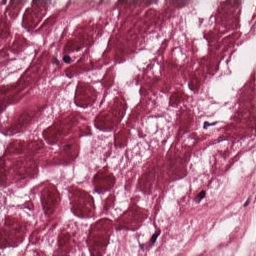

In [ ]:
from PIL import Image
with torch.amp.autocast('cuda'):
    samples = pipeline(uni_embeds=uncond, negative_uni_embeds=None, guidance_scale=1.0)

# Display the generated image
display(samples.images[0])

In [9]:
import cv2
import numpy as np

def calculate_whitespace_ratio(image, white_threshold=240):
    """
    Calculate percentage of white/background pixels.
    Returns: whitespace ratio (0-1)
    """
    img_array = np.array(image)
    grayscale = cv2.cvtColor(img_array, cv2.COLOR_RGB2GRAY)
    white_pixels = np.sum(grayscale > white_threshold)
    total_pixels = grayscale.size
    return white_pixels / total_pixels

In [10]:
from PIL import Image
from huggingface_hub import hf_hub_download

def generate_image(img_path, samples_req=1, retry=3):
    if retry == 0:
        return []

    # This is an example image we provide
    # path = hf_hub_download(repo_id="StonyBrook-CVLab/PixCell-256", filename=img_path)
    image = Image.open(img_path).convert("RGB")
    # image = image.resize((256, 256), Image.BICUBIC)

    # Extract UNI embedding from the image
    uni_inp = transform(image).unsqueeze(dim=0)
    with torch.inference_mode():
        uni_emb = uni_model(uni_inp.to(device))

    # reshape UNI to (bs, 1, D)
    uni_emb = uni_emb.unsqueeze(1)
    print("Extracted UNI:", uni_emb.shape)

    # Get unconditional embedding for classifier-free guidance
    uncond = pipeline.get_unconditional_embedding(uni_emb.shape[0])
    # Generate new samples
    with torch.amp.autocast('cuda'):
        samples = pipeline(uni_embeds=uni_emb, negative_uni_embeds=uncond, guidance_scale=3., num_images_per_prompt=samples_req).images

    max_whitespace = 0.4
    valid = [s for s in samples if calculate_whitespace_ratio(s) <= max_whitespace]

    if len(valid) > 0:
        return samples
    else:
        return generate_image(img_path, samples_req, retry - 1)

In [11]:
import os
import math
import shutil
import pandas as pd
from tqdm.auto import tqdm

def generate_images(in_csv_path, out_csv_path, in_img_dir, out_img_dir, samples_per_class):
    df_in = pd.read_csv(in_csv_path)
    df_out = []

    os.makedirs(out_img_dir, exist_ok=True)

    labels = df_in['label'].unique().tolist()

    for label in tqdm(labels, desc="Generating per class"):
        df_in_label = df_in[df_in['label'] == label]
        req_samples = max(0, samples_per_class - len(df_in_label))
        if req_samples == 0:
            continue

        req_samples_per = math.ceil(req_samples / len(df_in_label))

        for img_name in df_in_label['image_name']:
            src_path = os.path.join(in_img_dir, img_name)
            os.makedirs(os.path.join(out_img_dir, label), exist_ok=True)
            dst_path = os.path.join(out_img_dir, label, os.path.basename(img_name))

            try:
                shutil.copy(src_path, dst_path)
                df_out.append({"image_name": os.path.basename(img_name), "label": label})
            except Exception as e:
                print(f"⚠️ Could not copy {src_path}: {e}")

            img_path = os.path.join(in_img_dir, img_name)
            samples = []
            for _ in range(req_samples_per):
                try:
                    samples += generate_image(img_path)
                except Exception as e:
                    print(f"⚠️ Could not generate images for {img_path}: {e}")

            for i, sample in enumerate(samples):
                base_name = os.path.splitext(os.path.basename(img_name))[0]
                out_img_name = f"{base_name}_aug_{i}.png"
                out_img_path = os.path.join(out_img_dir, label, out_img_name)

                sample.save(out_img_path)
                df_out.append({"image_name": out_img_name, "label": label})

    df_out = pd.DataFrame(df_out)
    df_out.to_csv(out_csv_path, index=False)
    print(f"✅ Generated images and saved metadata to {out_csv_path}")

In [12]:
from sklearn.model_selection import train_test_split
def perpare_dataset(in_csv_file, in_img_dir, out_base_path, samples_per_class_dict):
    df = pd.read_csv(in_csv_file)
    train_df, temp_df = train_test_split(df, test_size=0.5, stratify=df['label'])
    val_df, test_df = train_test_split(temp_df, test_size=0.5, stratify=temp_df['label'])

    os.makedirs(out_base_path, exist_ok=True)

    train_df.to_csv("train.csv", index=False)
    val_df.to_csv("val.csv", index=False)
    test_df.to_csv("test.csv", index=False)

    splits = ['train', 'val', 'test']
    splits_csv = [f"{split}.csv" for split in splits]

    for split, split_csv in zip(splits, splits_csv):
        split_dir = os.path.join(out_base_path, split)
        os.makedirs(split_dir, exist_ok=True)

        generate_images(
            split_csv,
            f"{out_base_path}/{split}.csv",
            in_img_dir,
            f"{out_base_path}/{split}",
            samples_per_class_dict[split]
        )
        print(f"✅ Generated images for {split}")

    print(f"✅ Prepared dataset at {out_base_path}")

In [13]:
pd.read_csv("Dataset/image_labels.csv")['label'].value_counts()

,count
label,
Esophagogastric Cancer,254
Esophageal Squamous Cell Carcinoma,90
Esophageal Adenocarcinoma,81


In [14]:
perpare_dataset(
    "Dataset/image_labels.csv",
    "Dataset/images",
    "dataset",
    {
        "train": 720,
        "test": 0,
        "val": 0
    }
)

Generating per class:   0%|          | 0/3 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

/usr/local/lib/python3.12/dist-packages/PIL/Image.py:3452: DecompressionBombWarning: Image size (92165542 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

Extracted UNI: torch.Size([1, 1, 1536])


  0%|          | 0/20 [00:00<?, ?it/s]

In [ ]:
!zip -r9 dataset.zip dataset

updating: dataset/ (stored 0%)
  adding: dataset/train.csv (deflated 94%)
  adding: dataset/val/ (stored 0%)
  adding: dataset/val/Esophageal Adenocarcinoma/ (stored 0%)
  adding: dataset/val/Esophageal Adenocarcinoma/TCGA-L5-A4OH-01A-01-TS1.603E1371-EEB4-4121-84F7-E5AFC80F2A2A_aug_0.png (deflated 0%)
  adding: dataset/val/Esophageal Adenocarcinoma/TCGA-JY-A6F8-01A-01-TS1.DFFE9416-1B00-4D15-9322-D2B614CDC9B3_aug_2.png (deflated 0%)
  adding: dataset/val/Esophageal Adenocarcinoma/TCGA-JY-A93C-01A-01-TS1.EF73FF6A-7581-4EAB-85CC-8AA02ECFC1D2_aug_2.png (deflated 0%)
  adding: dataset/val/Esophageal Adenocarcinoma/TCGA-V5-A7RE-01A-01-TS1.4D082043-4E65-4E8A-9E38-F694E3AE9558_aug_1.png (deflated 0%)
  adding: dataset/val/Esophageal Adenocarcinoma/TCGA-2H-A9GL-11A-01-TS1.BCD078E1-A1AB-459A-87D4-147BDDD95871_aug_6.png (deflated 0%)
  adding: dataset/val/Esophageal Adenocarcinoma/TCGA-L5-A8NM-01A-01-TS1.361AF7A2-63A4-4BD1-960C-491A38E53E2B_aug_8.png (deflated 0%)
  adding: dataset/val/Esophageal

In [ ]:
!cp dataset.zip drive/MyDrive/dataset2.zip

In [ ]:
import random
import matplotlib.pyplot as plt

def visualize_samples(img_dir, num_samples=9):
    image_files = [f for f in os.listdir(img_dir) if os.path.isfile(os.path.join(img_dir, f))]
    if len(image_files) < num_samples:
        print(f"Warning: Only {len(image_files)} images found in {img_dir}. Displaying all available images.")
        num_samples = len(image_files)

    selected_images = random.sample(image_files, num_samples)

    plt.figure(figsize=(10, 10))
    for i, img_file in enumerate(selected_images):
        img_path = os.path.join(img_dir, img_file)
        img = Image.open(img_path)
        plt.subplot(3, 3, i + 1)
        plt.imshow(img)
        plt.axis('off')
    plt.show()

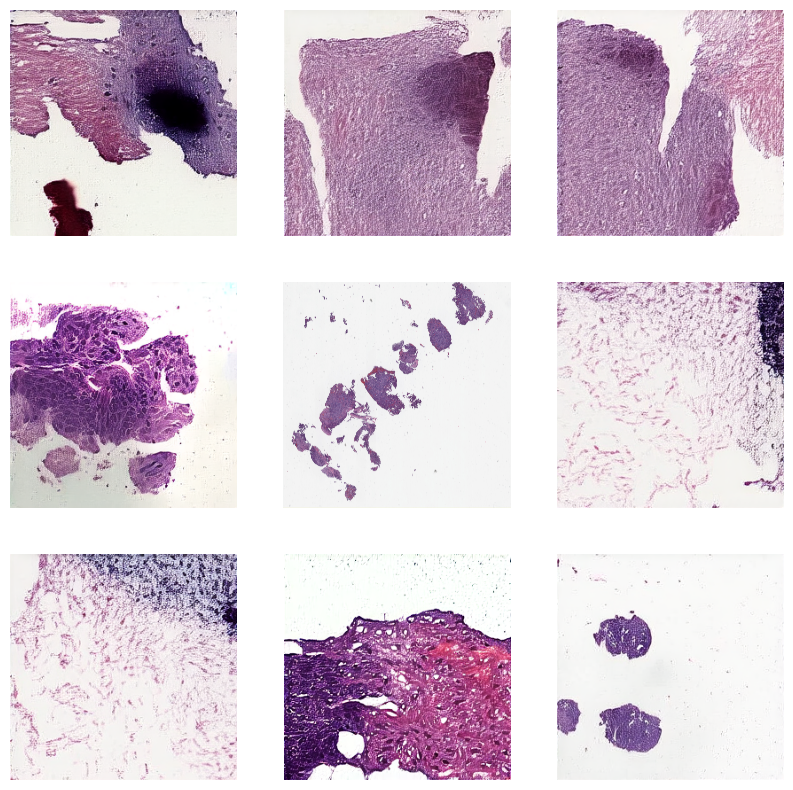

In [ ]:
visualize_samples("/content/dataset/train/Esophageal Adenocarcinoma")

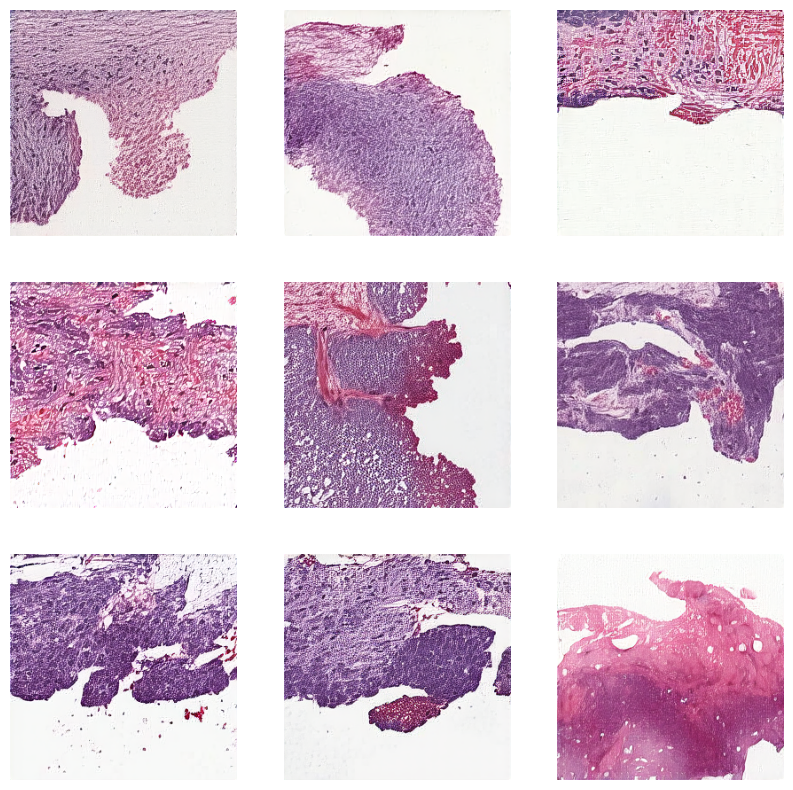

In [ ]:
visualize_samples("/content/dataset/train/Esophageal Squamous Cell Carcinoma")

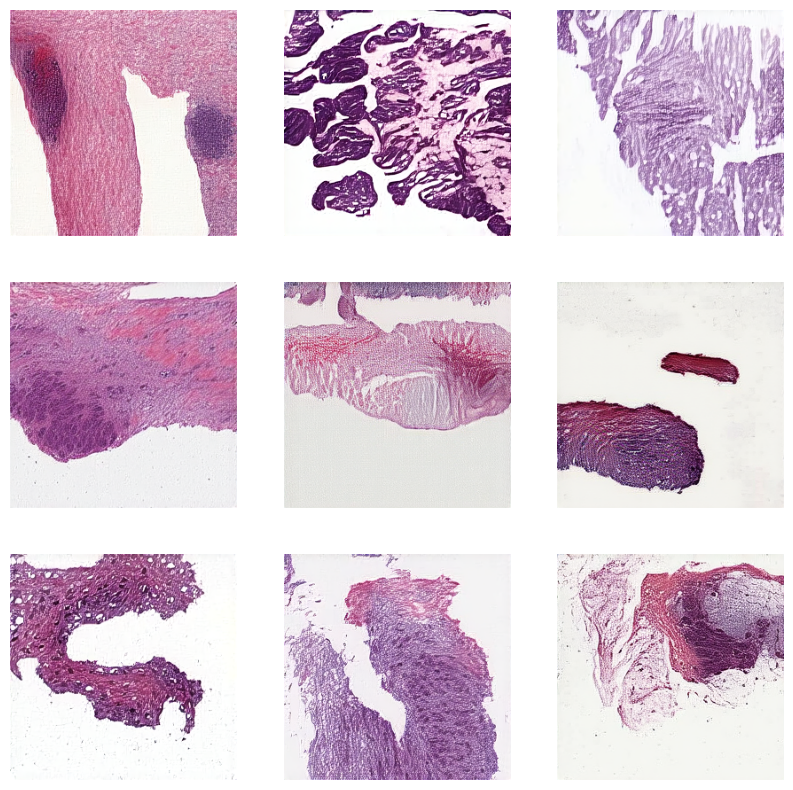

In [ ]:
visualize_samples("/content/dataset/train/Esophagogastric Cancer")

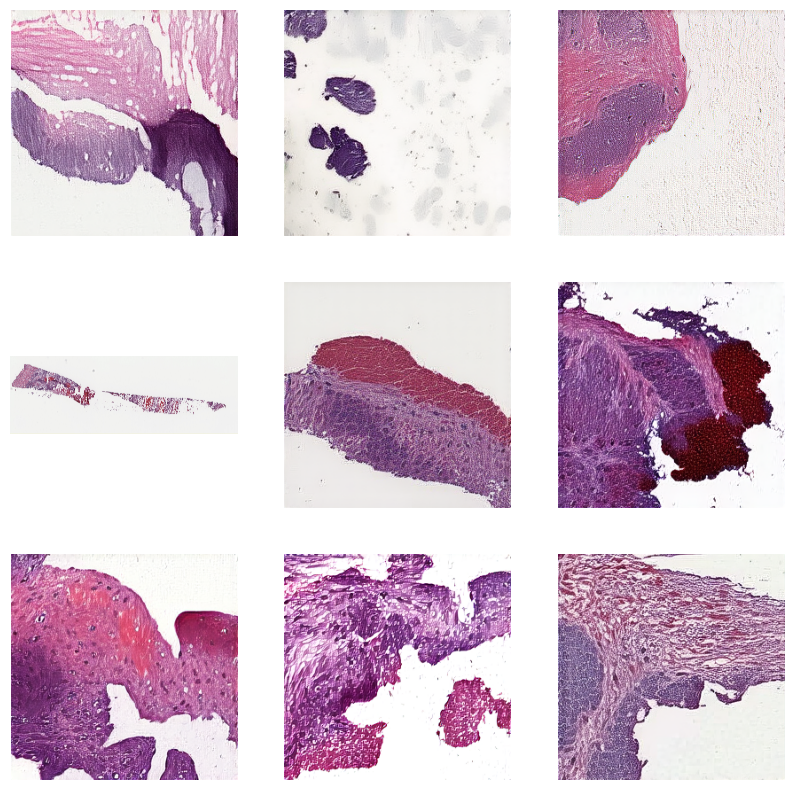

In [ ]:
visualize_samples("dataset/test")

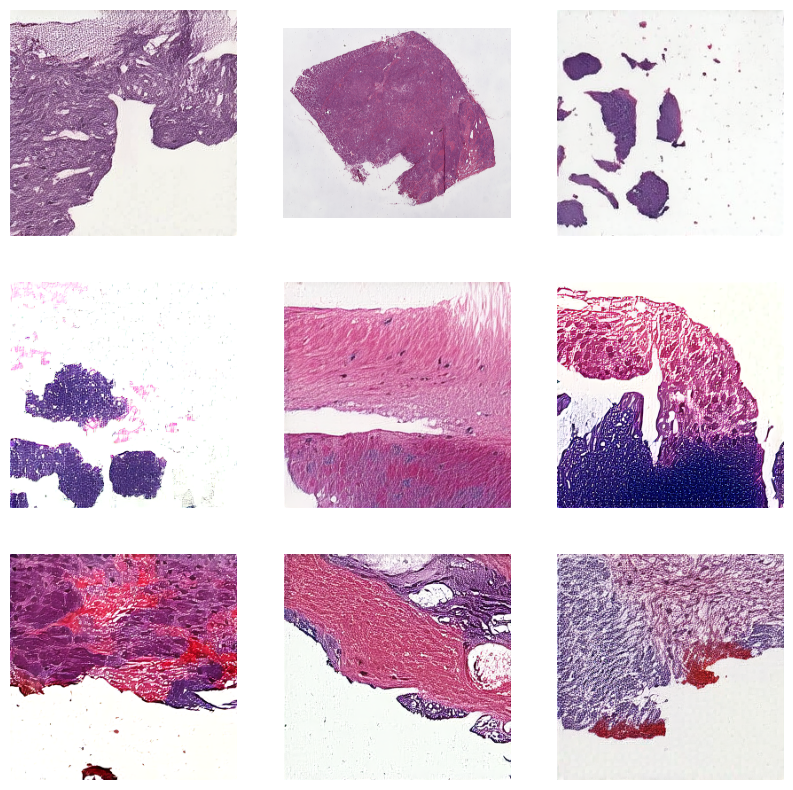

In [ ]:
visualize_samples("dataset/val")

In [ ]:
df = pd.read_csv("/content/dataset/val.csv")
df.head()

,image_name,label
0,TCGA-JY-A6F8-01A-01-TS1.DFFE9416-1B00-4D15-932...,Esophageal Adenocarcinoma
1,TCGA-BR-7703-11A-01-TS1.d25e758e-0295-46a5-bd4...,Esophagogastric Cancer
2,TCGA-L5-A4ON-01A-01-TSA.64169B2A-429E-4BBA-8A1...,Esophageal Adenocarcinoma
3,TCGA-L5-A4OI-11A-01-TS1.81D1F46D-9071-47C3-BFB...,Esophageal Adenocarcinoma
4,TCGA-IG-A3YB-01A-01-TSA.FF45C927-1A61-43E9-8EE...,Esophageal Squamous Cell Carcinoma


In [ ]:
df['label'].value_counts()

,count
label,
Esophageal Squamous Cell Carcinoma,162
Esophagogastric Cancer,156
Esophageal Adenocarcinoma,154


In [ ]:
!zip -r9 dataset.zip dataset

  adding: dataset/ (stored 0%)
  adding: dataset/train.csv (deflated 82%)
  adding: dataset/val/ (stored 0%)
  adding: dataset/val/Esophageal Adenocarcinoma/ (stored 0%)
  adding: dataset/val/Esophageal Adenocarcinoma/TCGA-L5-A8NF-11A-01-TS1.D86E8DE6-B6C9-429D-A8ED-3FF90667AD5C_aug_10.png (deflated 0%)
  adding: dataset/val/Esophageal Adenocarcinoma/TCGA-L5-A8NE-01A-01-TS1.F5D2D2E9-9262-4B08-9C38-D8FAE0E4BEBD.jpg (deflated 6%)
  adding: dataset/val/Esophageal Adenocarcinoma/TCGA-R6-A8WG-01Z-00-DX1.7DFEC264-444A-456F-8EC5-61D82657F716_aug_2.png (deflated 0%)
  adding: dataset/val/Esophageal Adenocarcinoma/TCGA-L5-A4OW-11A-01-TS1.531D7EA5-0F52-4E70-AAE0-5E426D87F398_aug_7.png (deflated 0%)
  adding: dataset/val/Esophageal Adenocarcinoma/TCGA-2H-A9GL-11A-01-TS1.BCD078E1-A1AB-459A-87D4-147BDDD95871_aug_6.png (deflated 0%)
  adding: dataset/val/Esophageal Adenocarcinoma/TCGA-2H-A9GI-01A-01-TSA.10BB401B-144B-498C-954A-EF6D41DF6CFC_aug_7.png (deflated 0%)
  adding: dataset/val/Esophageal Aden

In [ ]:
!cp dataset.zip drive/MyDrive/dataset1.zip

In [ ]:
!du -sh dataset.zip

1.5G	dataset.zip
